## Grid

1. 每个网格设置一个阈值，超过阈值的线条不计入网格内
2. 网格位置的挑选
3. 网格聚类标签颜色映射，重新设计

根据每条线条所穿过的网格，然后根据涉及到的网格以及对应的聚类，然后对线条归类；最后会在原始ascore上面

In [1]:
import numpy as np
import pandas as pd
from gridMultiprocessing import calculate_grid_density
import pickle

grid_density, grid_vectors = calculate_grid_density('rank.csv', 'rel.csv', num_processes=4)

Total computation time: 47.42 seconds


In [2]:
# line set， line density
grid_vectors, grid_density

(array([[set(), set(), set(), ..., set(), set(), set()],
        [set(), set(), set(), ..., set(), set(), set()],
        [set(), set(), set(), ..., set(), set(), set()],
        ...,
        [set(), set(), set(), ..., set(), set(), set()],
        [set(), set(), set(), ..., set(), set(), set()],
        [set(), set(), set(), ..., set(), set(), set()]], dtype=object),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]]))

In [4]:
grid_density_int = grid_density.astype(int)
# 将转换后的 grid_density 写成文本保存
np.savetxt('grid-html/assets/grid_counts_test.txt', grid_density_int, fmt='%d')

## Sample

In [7]:
# 找出高密度区域和低密度区域的阈值
high_density_threshold = np.percentile(grid_density, 90)
low_density_threshold = np.percentile(grid_density, 10)

# 获取网格所在坐标
high_density_coords = np.argwhere(grid_density >= high_density_threshold)
low_density_coords = np.argwhere(grid_density <= low_density_threshold)

# 随机采样10%的高密度区域
np.random.seed(0)
high_density_samples = high_density_coords[
    np.random.choice(len(high_density_coords), len(high_density_coords) // 7, replace=False)]
low_density_samples = low_density_coords[
    np.random.choice(len(low_density_coords), len(low_density_coords) // 10, replace=False)]

In [8]:
high_density_samples

array([[282, 601],
       [567, 519],
       [406, 649],
       ...,
       [570, 534],
       [345, 627],
       [186, 360]], dtype=int64)

## calc sample grid overlap

In [9]:
def overlap(vec1, vec2):
    """
    grid重叠系数计算
    :param vec1: 
    :param vec2: 
    :return: 
    """
    vec1 = np.array(list(vec1))
    vec2 = np.array(list(vec2))
    intersection = len(set(vec1).intersection(set(vec2)))
    min_set = min(len(vec1), len(vec2))
    return intersection / min_set if min_set > 0 else 0


def calc_neighborhood(sampled_coords, grid_vectors):
    """
    计算邻近的网格重叠系数
    :param sampled_coords: 
    :param grid_vectors: 
    :return: 
    """
    overlap_scores = {}

    for coord in sampled_coords:
        y, x = coord
        sampled_set = grid_vectors[y, x]
        neighbors = []

        # 获取邻近的网格
        for dy in [-1, 0, 1]:
            for dx in [-1, 0, 1]:
                if dy == 0 and dx == 0:
                    continue  # 跳过自身
                ny, nx = y + dy, x + dx
                if 0 <= ny < grid_vectors.shape[0] and 0 <= nx < grid_vectors.shape[1]:
                    neighbors.append((ny, nx))

        for ny, nx in neighbors:
            neighbor_set = grid_vectors[ny, nx]
            overlap1 = overlap(sampled_set, neighbor_set)
            overlap_scores[(y, x, ny, nx)] = overlap1

    return overlap_scores

In [8]:
# num_samples = len(high_density_samples) + len(low_density_samples)
# all_samples = np.vstack((high_density_samples, low_density_samples))

num_samples = len(high_density_samples)
all_samples = high_density_samples

overlap_scores = calc_neighborhood(all_samples, grid_vectors)

In [9]:
overlap_scores
len(all_samples)

4913

## calc sample grid distance matrix

In [10]:
from distanceMatrixmp import parallel_distance_matrix_calculation

# 执行多进程计算
distance_matrix, grid_dict = parallel_distance_matrix_calculation(all_samples, overlap_scores)

## cluster by distance matrix

In [11]:
# 每个网格除了有线条集合，还要创建对应的特征向量（用稀疏向量表示）
# 聚类就是根据距离最近合并两个，然后更新平均特征向量
# ab合成簇，ac和bc的距离平均就是ab到c的距离

In [12]:
def create_sparse_feature_vectors(grid_vectors):
    """
    创建稀疏特征向量
    :param grid_vectors: 
    :return: 
    """
    feature_vectors = {}

    for y in range(grid_vectors.shape[0]):
        for x in range(grid_vectors.shape[1]):
            line_ids = grid_vectors[y, x]
            if line_ids:  # 仅存储非空的网格
                # 稀疏表示为一个字典，key为线条ID，value为1（因为存在该线条）
                sparse_vector = {line_id: 1 for line_id in line_ids}
                feature_vectors[(y, x)] = sparse_vector

    return feature_vectors


grid_feature = create_sparse_feature_vectors(grid_vectors)

In [21]:
grid_vectors
grid_feature

{(0, 340): {438148: 1,
  523411: 1,
  433670: 1,
  447756: 1,
  110861: 1,
  447757: 1,
  447758: 1,
  609680: 1,
  395218: 1,
  447762: 1,
  110868: 1,
  382100: 1,
  386326: 1,
  110935: 1,
  303128: 1,
  386327: 1,
  386328: 1,
  401690: 1,
  382108: 1,
  622427: 1,
  312425: 1,
  312426: 1,
  110891: 1,
  598387: 1,
  598388: 1,
  581557: 1,
  536697: 1,
  536701: 1},
 (0, 341): {536705: 1,
  536706: 1,
  382115: 1,
  523418: 1,
  536713: 1,
  433680: 1,
  447763: 1,
  598389: 1,
  31606: 1,
  189303: 1,
  382109: 1,
  111001: 1,
  385530: 1,
  118141: 1,
  385535: 1},
 (0, 342): {653185: 1,
  612616: 1,
  16777: 1,
  365967: 1,
  536720: 1,
  536721: 1,
  536724: 1,
  536725: 1,
  536727: 1,
  536728: 1,
  433690: 1,
  433691: 1,
  269341: 1,
  401694: 1,
  401695: 1,
  401696: 1,
  523421: 1,
  89900: 1,
  516142: 1,
  90671: 1,
  467247: 1,
  467248: 1,
  467249: 1,
  467250: 1,
  203572: 1,
  174901: 1,
  566198: 1,
  462392: 1,
  462393: 1,
  462394: 1,
  462395: 1,
  579006: 

In [23]:
import numpy as np
from tqdm import tqdm


def hierarchical_clustering(distance_matrix):
    # 初始化标签为每个元素的索引
    labels = np.arange(distance_matrix.shape[0])
    initial_count = distance_matrix.shape[0]  # 记录初始元素数量以计算进度

    # tqdm中使用manual update来显示进度条
    pbar = tqdm(total=initial_count - 4)  # 设置进度条总步数

    while len(labels) > 4:
        # 只考虑上三角矩阵，排除对角线（不包含自身）
        upper_triangle_indices = np.triu_indices(distance_matrix.shape[0], k=1)

        # 找到最小距离的索引
        min_index = np.argmin(distance_matrix[upper_triangle_indices])
        i, j = upper_triangle_indices[0][min_index], upper_triangle_indices[1][min_index]

        # 计算新簇与其他簇的距离（使用上三角矩阵和平均链接法）
        new_distances = (distance_matrix[i, :] + distance_matrix[j, :]) / 2.0

        # 删除已合并的行和列
        mask = np.ones(distance_matrix.shape[0], dtype=bool)
        mask[[i, j]] = False
        distance_matrix = distance_matrix[mask, :][:, mask]

        # 添加新簇与其他簇的距离（新行列）
        distance_matrix = np.vstack([distance_matrix, new_distances[mask]])
        new_distances = np.append(new_distances[mask], 0)  # 添加0以保持对角线
        distance_matrix = np.hstack([distance_matrix, new_distances[:, None]])

        # 平铺展开标签并创建新标签
        def flatten_label(label):
            return str(label).strip('()').split(',')

        new_label_elements = flatten_label(labels[i]) + flatten_label(labels[j])
        new_label = f"({','.join(sorted(set(new_label_elements), key=int))})"

        # 更新标签
        labels = labels[mask]
        labels = np.append(labels, new_label)

        # 更新进度条
        pbar.update(1)  # 每次合并后更新进度条

    pbar.close()  # 完成后关闭进度条
    return labels


final_labels = hierarchical_clustering(distance_matrix)
final_labels

100%|██████████| 4909/4909 [22:16<00:00,  3.67it/s]  


array(['(1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682,1683,1684,1685,1686,1687,1688,1689,1690,1691,1692,1693,1694,1695,1696,1697,1698,1699,1700,1701,1702,1703,1704,1705,1706,1707,1708,1709,1710,1711,1712,1713,1714,1715,1716,1717,1718,1719,1720,1721,1722,1723,1724,1725,1726,1727,1728,1729,1730,1731,1732,1733,1734,1735,1736,1737,1738,1739,1740,1741,1742,1743,1744,1745,1746,1747,1748,1749,1750,1751,1752,1753,1754,1755,1756,1757,1758,1759,1760,1761,1762,1763,1764,1765,1766,1767,1768,1769,1770,1771,1772,1773,1774,1775,1776,1777,1778,1779,1780,1781,1782,1783,1784,1785,1786,1787,1788,1789,1790,1791,1792,1793,1794,1795,1796,1797,1798,1799,1800,1801,1802,1803,1804,1805,1806,1807,1808,1809,1810,1811,1812,1813,1814,1815,1816,1817,1818,1819,1820,1821,1822,1823,1824,1825,1826,1827,1828,1829,1830,1831,1

In [24]:
np.save('final_labels.npy', final_labels)

In [13]:
final_labels = np.load('final_labels.npy')

## other grid distrubute cluster

In [14]:
# cluster 编号+构建字典k-v   编号-涉及聚簇元素的真实网格坐标
cluster_dict = {}
for i, label in enumerate(final_labels):
    if ',' in label:
        elements = label.strip('()').split(',')
        for elem in elements:
            key = int(elem)
            if i not in cluster_dict:
                cluster_dict[i] = []
            cluster_dict[i].append(grid_dict[key])
    else:
        cluster_dict[i] = grid_dict[int(label)]

cluster_dict

{0: [array([357, 525], dtype=int64),
  array([274, 540], dtype=int64),
  array([339, 560], dtype=int64),
  array([355, 579], dtype=int64),
  array([174, 649], dtype=int64),
  array([503, 366], dtype=int64),
  array([480, 458], dtype=int64),
  array([535, 547], dtype=int64),
  array([315, 590], dtype=int64),
  array([269, 501], dtype=int64),
  array([265, 573], dtype=int64),
  array([260, 499], dtype=int64),
  array([418, 538], dtype=int64),
  array([185, 629], dtype=int64),
  array([416, 591], dtype=int64),
  array([295, 499], dtype=int64),
  array([416, 457], dtype=int64),
  array([464, 451], dtype=int64),
  array([451, 453], dtype=int64),
  array([274, 443], dtype=int64),
  array([252, 598], dtype=int64),
  array([487, 362], dtype=int64),
  array([247, 479], dtype=int64),
  array([514, 384], dtype=int64),
  array([339, 687], dtype=int64),
  array([306, 523], dtype=int64),
  array([325, 683], dtype=int64),
  array([355, 662], dtype=int64),
  array([466, 497], dtype=int64),
  array([24

In [15]:
# 计算每个簇的平均特征向量，用字典+稀疏向量表示， cluster_vector
from collections import defaultdict

# 初始化 cluster_avg_vector
cluster_avg_vector = defaultdict(lambda: {})


def process_vector_list(v):
    sum_vector = defaultdict(float)

    for item in v:
        if isinstance(item, np.ndarray):
            item_tuple = tuple(item)
            try:
                feature_vector = grid_feature[item_tuple]
                for index, value in feature_vector.items():
                    sum_vector[index] += value
            except KeyError:
                continue
        elif isinstance(item, list):
            nested_sum_vector = process_vector_list(item)
            for index, value in nested_sum_vector.items():
                sum_vector[index] += value

    return sum_vector


# 遍历 cluster_dict
for k, v in cluster_dict.items():
    # 如果簇中只有一个元素，直接使用该元素的特征向量作为平均特征向量
    if isinstance(v, np.ndarray):
        try:
            cluster_avg_vector[k] = grid_feature[v[0], v[1]]
        except KeyError:
            continue
    # 如果簇中有多个元素，计算总特征向量然后求平均
    else:
        sum_vector = process_vector_list(v)
        if sum_vector:
            avg_vector = {index: value / len(v) for index, value in sum_vector.items()}
            cluster_avg_vector[k] = avg_vector


In [16]:
cluster_dict.keys()

dict_keys([0, 1, 2, 3])

In [17]:
def truncate_float(number, digits):
    stepper = 10.0 ** digits
    return np.trunc(stepper * number) / stepper


def truncate_dict_values(d, digits):
    return {k: np.float32(truncate_float(v, digits)) for k, v in d.items()}


# 使用 float32 精度
for key, value in cluster_avg_vector.items():
    cluster_avg_vector[key] = truncate_dict_values(value, 6)  # 将精度调整为小数点后6位

In [18]:
cluster_avg_vector

defaultdict(<function __main__.<lambda>()>,
            {0: {614400: 0.004882,
              43015: 0.007812,
              43016: 0.007812,
              43018: 0.007812,
              43022: 0.007812,
              43023: 0.007812,
              227345: 0.005859,
              96277: 0.006835,
              180254: 0.003906,
              376870: 0.001953,
              647207: 0.004882,
              647208: 0.004882,
              466986: 0.006835,
              438327: 0.002929,
              213048: 0.006835,
              227389: 0.003906,
              227391: 0.003906,
              565318: 0.001953,
              565319: 0.001953,
              227400: 0.005859,
              227401: 0.005859,
              227402: 0.005859,
              565320: 0.001953,
              565321: 0.002929,
              227405: 0.005859,
              227406: 0.005859,
              565322: 0.002929,
              565324: 0.003906,
              565325: 0.003906,
              565327: 0.003906,

In [19]:
# grid_feature[539,665]
# cluster_dict[0]
set(grid_feature[539, 665]) - set(cluster_avg_vector[0])

KeyError: (539, 665)

In [ ]:
test_label = 0
cluster_avg_vector[test_label]
cluster_dict[test_label]
# (set(grid_feature[292,703])
#  (set(grid_feature[403,485])))
# final_labels[15847]
# distance_matrix[1,0]

print(f'聚类编号: {test_label}', '聚类元素数量:', cluster_dict[test_label])
print(f'聚类平均特征向量: {cluster_avg_vector[test_label]}')
# print(f'聚类元素的特征向量: {(set(grid_feature[292, 703]) - (set(grid_feature[403, 485])))}')
print(f'聚类对应的采样网格编号: {final_labels[test_label]}')
# print(f'聚类元素的距离矩阵中的关系: {distance_matrix[0, 1]}')

In [ ]:
"""
    grid_vectors：所有网格线条集合
    grid_density：所有网格密度
    all_samples：采样网格坐标（高 低密度）
    overlap_scores：采样网格重叠系数
    distance_matrix：采样网格距离矩阵
    grid_dict：采样网格编号 + 真实网格坐标
    grid_feature：所有网格特征向量，稀疏表示
    
    final_labels：采样网格的聚类标签和对应采样网格编号
    cluster_dict：聚类编号：元素真实网格坐标
    cluster_avg_vector：聚类平均特征向量
    sample_grid_set：采样网格集合，O1复杂度，包含了采样网格的真实坐标
    coord_cluster_dict：真实网格坐标：聚类编号
    
"""
# 构建采样网格集合
sample_grid_list = []
for value in cluster_dict.values():
    if isinstance(value, np.ndarray):

        sample_grid_list.append(value)
    elif isinstance(value, list):
        for item in value:
            sample_grid_list.append(item)

sample_grid_set = {tuple(grid) for grid in sample_grid_list}

# 检查是否包含 [0, 0] 元素
(616, 235) in sample_grid_set

In [ ]:
coord_cluster_dict = {}

for k, v in cluster_dict.items():
    if isinstance(v, np.ndarray):
        coord_cluster_dict[tuple(v)] = k
    elif isinstance(v, list):
        for item in v:
            coord_cluster_dict[tuple(item)] = k

coord_cluster_dict

In [ ]:
# 并行计算划分整个原始网格，每个进程构建一个空value的dict，key则对应cluster_dict的key；
# 对于非采样网格从grid feature中取出特征向量，计算和所有簇的cluster_vector距离，取最小的簇，加入到对应的dict中
# 合并所有进程的dict，得到最终的cluster
#这样我遍历整个原始网格，然后根据每个网格的真实坐标取grid dict values中查看是否存在，不存在则说明该网格是未被采样的，需要进行操作；存在则跳过该网格；

In [20]:
import numpy as np
import faiss
from tqdm import tqdm

grid_size = 700
marked_grid = np.zeros((grid_size, grid_size), dtype=int)


# 将稀疏向量转换为稠密向量用于 faiss 处理
def sparse_to_dense(sparse_vec, dimension):
    dense_vec = np.zeros(dimension, dtype=np.float32)
    for k, v in sparse_vec.items():
        dense_vec[k] = v
    return dense_vec


# 构建 faiss 索引
dimension = 700000  # 向量的维度
index = faiss.IndexFlatL2(dimension)  # 欧氏距离的索引类型

# 将聚类中心向量添加到索引中
cluster_ids = []
for cluster_id, avg_vector in cluster_avg_vector.items():
    dense_vec = sparse_to_dense(avg_vector, dimension)
    index.add(np.array([dense_vec]))
    cluster_ids.append(cluster_id)

# 遍历网格并显示进度条
coord_cluster_dict = {}
total_grids = grid_size * grid_size
with tqdm(total=total_grids, desc="Processing Grids") as pbar:
    for x in range(grid_size):
        for y in range(grid_size):
            # 更新标记
            marked_grid[x, y] = 1

            # 如果网格没有特征向量，跳过
            if (x, y) not in grid_feature:
                pbar.update(1)
                continue

            # 如果网格已经有聚类标签，跳过
            if (x, y) in coord_cluster_dict:
                pbar.update(1)
                continue

            # 获取当前网格的稠密向量
            current_vector = sparse_to_dense(grid_feature[(x, y)], dimension)

            # 使用 faiss 进行最近邻搜索
            D, I = index.search(np.array([current_vector]), 1)  # 搜索最近的一个聚类中心

            # 分配聚类标签
            best_cluster = cluster_ids[I[0][0]]
            coord_cluster_dict[(x, y)] = best_cluster

            # 更新进度条
            pbar.update(1)

# 最终结果
print("Marked grid:")
print(marked_grid)
print("Updated coord_cluster_dict:")
print(coord_cluster_dict)

Processing Grids: 100%|██████████| 490000/490000 [10:56<00:00, 745.91it/s] IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




In [35]:
zero_count = np.sum(grid_density == 0)
len(coord_cluster_dict.keys()) + zero_count

490000

In [40]:
# 保存结果
cluster_array = np.full((grid_size, grid_size), -1, dtype=int)
for (x, y), cluster_label in coord_cluster_dict.items():
    cluster_array[x, y] = cluster_label

np.savetxt('grid-html/assets/grid_cluster.txt', cluster_array, fmt='%d')

In [51]:
from collections import defaultdict

# 初始化一个字典来存储每个聚类的特征向量总和及其数量
cluster_feature_sum = defaultdict(lambda: defaultdict(float))
cluster_count = defaultdict(int)

# 遍历每个网格坐标
for coord, cluster in coord_cluster_dict.items():
    # 获取该网格对应的稀疏特征向量
    feature_vector = grid_feature[coord]

    # 将该稀疏特征向量加到对应聚类的总和中
    for index, value in feature_vector.items():
        cluster_feature_sum[cluster][index] += value

    # 计数
    cluster_count[cluster] += 1

# 计算每个聚类的平均特征向量
all_cluster_avg_feature = {}
for cluster, feature_sum in cluster_feature_sum.items():
    avg_feature_vector = {index: value / cluster_count[cluster] for index, value in feature_sum.items()}
    all_cluster_avg_feature[cluster] = avg_feature_vector

# 输出结果
for cluster, avg_vector in all_cluster_avg_feature.items():
    print(f"Cluster {cluster} average feature vector: {avg_vector}")


IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [53]:
cluster_avg_vector.values()

dict_values([{614400: 0.004882, 43015: 0.007812, 43016: 0.007812, 43018: 0.007812, 43022: 0.007812, 43023: 0.007812, 227345: 0.005859, 96277: 0.006835, 180254: 0.003906, 376870: 0.001953, 647207: 0.004882, 647208: 0.004882, 466986: 0.006835, 438327: 0.002929, 213048: 0.006835, 227389: 0.003906, 227391: 0.003906, 565318: 0.001953, 565319: 0.001953, 227400: 0.005859, 227401: 0.005859, 227402: 0.005859, 565320: 0.001953, 565321: 0.002929, 227405: 0.005859, 227406: 0.005859, 565322: 0.002929, 565324: 0.003906, 565325: 0.003906, 565327: 0.003906, 565328: 0.000976, 249940: 0.002929, 450643: 0.003906, 450644: 0.005859, 450648: 0.005859, 499801: 0.003906, 450650: 0.003906, 450676: 0.004882, 649338: 0.007812, 649343: 0.007812, 75904: 0.002929, 565376: 0.001953, 565378: 0.004882, 565380: 0.003906, 565381: 0.000976, 565382: 0.000976, 213127: 0.004882, 614533: 0.003906, 450696: 0.004882, 450702: 0.005859, 450703: 0.005859, 389269: 0.002929, 358560: 0.000976, 415914: 0.002929, 595964: 0.000976, 624

In [60]:
import numpy as np
import matplotlib.pyplot as plt

# 获取聚类标签
clusters = list(cluster_avg_vector.keys())
num_clusters = len(clusters)

# 假设向量的最大维度（这个值应该基于实际特征维度设置）
max_dim = max([max(vector.keys()) for vector in cluster_avg_vector.values()]) + 1

# 计算欧式距离矩阵
dist_matrix = np.zeros((num_clusters, num_clusters))

for i in range(num_clusters):
    for j in range(i + 1, num_clusters):
        # 将稀疏向量转换为全维向量
        vec_i = np.zeros(max_dim)
        vec_j = np.zeros(max_dim)

        for k, v in cluster_avg_vector[clusters[i]].items():
            vec_i[k] = v
        for k, v in cluster_avg_vector[clusters[j]].items():
            vec_j[k] = v

        # 计算欧式距离
        dist_matrix[i, j] = np.linalg.norm(vec_i - vec_j)
        dist_matrix[j, i] = dist_matrix[i, j]  # 距离矩阵是对称的

# 设置标签3的颜色
fixed_color = np.array([172, 226, 224]) / 255.0  # 转换为[0, 1]范围内
cluster_colors = {}

# 将距离矩阵映射到色环的角度上，同时保持标签3的颜色
angles = np.linspace(0, np.pi, num_clusters, endpoint=False)
cmap = plt.get_cmap('hsv')

# 计算所有聚类的颜色，但固定标签3的颜色
for i, cluster in enumerate(clusters):
    if cluster == 3:
        cluster_colors[cluster] = tuple(fixed_color * 255)  # 保留为RGB
    else:
        angle_index = i if i < 3 else i - 1  # 跳过标签3的固定位置
        color = cmap(angle_index / (num_clusters - 1))
        rgb_color = (int(color[0] * 255), int(color[1] * 255), int(color[2] * 255))  # 转换为RGB
        cluster_colors[cluster] = rgb_color

# 打印每个聚类对应的颜色
for cluster, color in cluster_colors.items():
    print(f"Cluster {cluster} RGB color: {color}")

Cluster 0 RGB color: (255, 0, 0)
Cluster 1 RGB color: (7, 255, 0)
Cluster 2 RGB color: (0, 15, 255)
Cluster 3 RGB color: (172.0, 226.0, 224.0)


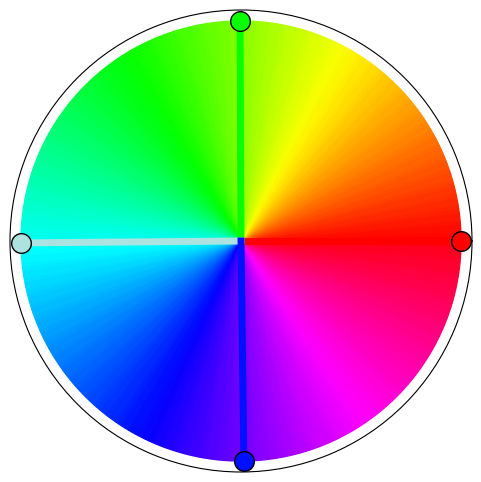

In [58]:
cluster_colors = {
    1: (255, 0, 0),  # 例如，红色
    2: (7, 255, 0),  # 例如，绿色
    3: (172, 226, 224),  # 你指定的颜色
    4: (0, 15, 255)
}

# 转换为 [0, 1] 范围内的颜色
for cluster, color in cluster_colors.items():
    cluster_colors[cluster] = tuple([c / 255.0 for c in color])

# 绘制色环
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw={'projection': 'polar'})
num_colors = 360  # 色环的细分数目
angles = np.linspace(0, 2 * np.pi, num_colors)
colors = plt.cm.hsv(np.linspace(0, 1, num_colors))

ax.set_xticks([])  # 隐藏角度标签
ax.set_yticks([])  # 隐藏径向标签

# 绘制色环
for i, angle in enumerate(angles):
    ax.bar(angle, 1, width=2 * np.pi / num_colors, color=colors[i], edgecolor=colors[i])

# 绘制聚类颜色
for i, (cluster, color) in enumerate(cluster_colors.items()):
    angle = angles[i * (num_colors // len(cluster_colors))]  # 均匀分布在色环上
    ax.plot([angle, angle], [0, 1], color=color, lw=5)
    ax.scatter([angle], [1], color=color, s=200, edgecolor='black', zorder=5)

plt.show()

In [82]:
# from noSampleGridCluster import parallel_cluster_assignment

grid_size = 800


# normal_dict = {k: v for k, v in cluster_avg_vector.items()}
# no_cluster_dict = parallel_cluster_assignment(grid_size, grid_feature, coord_cluster_dict, normal_dict, 4)
# with open('final_cluster_dict.pkl', 'wb') as f:
#     pickle.dump(no_cluster_dict, f)
# def calculate_sparse_euclidean_distance(vec1, vec2):
#     all_keys = set(vec1.keys()).union(set(vec2.keys()))
#     squared_diff_sum = 0.0
# 
#     for key in all_keys:
#         diff = vec1.get(key, 0.0) - vec2.get(key, 0.0)
#         squared_diff_sum += diff ** 2
# 
#     return np.sqrt(squared_diff_sum)

def calculate_sparse_euclidean_distance(vec1, vec2):
    intersection = len(set(vec1.keys()).intersection(set(vec2.keys())))
    union = len(set(vec1.keys()).union(set(vec2.keys())))
    return intersection / union


def calculate_min_distance_key(no_sample_grid_feature, cluster_avg_vector):
    min_distance = float('inf')
    min_key = None

    for key, cluster_vector in cluster_avg_vector.items():
        distance = calculate_sparse_euclidean_distance(no_sample_grid_feature, cluster_vector)

        if distance < min_distance:
            min_distance = distance
            min_key = key

    return min_key


from tqdm import tqdm

cluster_dict_process = {}
for i in tqdm(range(400, 401), desc="Processing i", leave=True):
    for j in tqdm(range(800), desc="Processing j", leave=False):
        if (i, j) in coord_cluster_dict:
            # 采样网格跳过
            continue
        else:
            # 非采样网格，计算与所有簇的欧式距离，取最小的簇并加入到对应的dict中
            no_sample_grid_feature = grid_feature.get((i, j))
            # 有线条经过的非采样网格，加入到对应的簇中
            if no_sample_grid_feature is not None:
                belong_cluster = calculate_min_distance_key(no_sample_grid_feature, cluster_avg_vector)
                if belong_cluster not in cluster_dict_process:
                    cluster_dict_process[belong_cluster] = [np.array([i, j])]
                else:
                    cluster_dict_process[belong_cluster].append(np.array([i, j]))
    break







Processing i:   0%|          | 0/1 [00:00<?, ?it/s]




Processing j:   0%|          | 0/800 [00:00<?, ?it/s]




Processing j:   6%|▌         | 47/800 [00:00<00:02, 363.21it/s]




Processing j:  10%|█         | 84/800 [00:02<00:24, 29.83it/s] 




Processing j:  12%|█▎        | 100/800 [00:03<00:27, 25.05it/s]




Processing j:  14%|█▍        | 110/800 [00:03<00:29, 23.04it/s]




Processing j:  15%|█▍        | 117/800 [00:04<00:31, 21.78it/s]




Processing j:  15%|█▌        | 122/800 [00:04<00:32, 20.91it/s]




Processing j:  16%|█▌        | 126/800 [00:04<00:33, 20.12it/s]




Processing j:  16%|█▌        | 129/800 [00:05<00:34, 19.57it/s]




Processing j:  16%|█▋        | 132/800 [00:05<00:35, 19.02it/s]




Processing j:  17%|█▋        | 135/800 [00:05<00:35, 18.50it/s]




Processing j:  17%|█▋        | 138/800 [00:05<00:36, 18.02it/s]




Processing j:  18%|█▊        | 140/800 [00:05<00:37, 17.73it/s]




Processing j:  18%|█▊        | 142/800 [00:05<00:37, 17.47it/s]


